# Naloga: katera žival?
* Bombonček #2: Prepoznava vrste živali iz slike

Uvodno pojasnilo: v mapi data najdemo učne datoteke, ki so razdeljene glede na kategorijo in se nahajajo v poddirektorijih "fish", "cat" in "bird", kar tudi pomaga pri razdelitvi na kategorije

<b> Zaradi testiranja drugega algoritma sem dodal 9 slik v testno množico, saj slutim, da je uporabljen dataset ('imagenet') zaradi tako velike natančnosti uporabljal enake slike za učno množico </b>

Testne datoteke so v mapi test, pomešane med seboj, 10 iz vsake kategorije

In [1]:
import matplotlib.pyplot as plt
import pathlib
import numpy as np
import PIL
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers

Nastavim spremenljivke - poti do map s slikami


In [2]:
potDatoteke = pathlib.Path('data/')
stevilo_razredov = 3

Število slik v vsaki mapi za učenje je 25, imamo 3 mape

In [3]:
print('Število vseh slik v mapah: ' + str(len(list(potDatoteke.glob('*/*.jpg')))))

Število vseh slik v mapah: 75


### Grafični prikaz

[Text(0, 0, 'bird'),
 Text(0, 0, 'cat'),
 Text(0, 0, 'fish'),
 Text(0, 0, 'testna')]

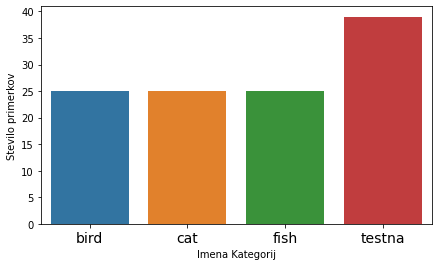

In [4]:
import seaborn as sns
import matplotlib.pyplot as plt
import os
import pandas as pd
#štetje slik
PticaRibaMacka = [] #ustvari/sprazni array
for dirpath, dirnames, filenames in os.walk("data/"):
    stevilo = len(filenames)
    if stevilo != 1 :
        PticaRibaMacka.append(stevilo)
        
for dirpath, dirnames, filenames in os.walk("test/"):
    stevilo = len(filenames)
    if stevilo != 1 :
        PticaRibaMacka.append(stevilo)
#pridobi imena kategorij iz imen map
imena_kategorij = [] #ustvari/sprazni array
for root, dirs, files in os.walk("data/", topdown=False):
    for name in dirs:
        imena_kategorij.append(os.path.join(name))
        
imena_kategorij.append("testna")
#izris grafa
fig_dims = (7,4)
fig, ax = plt.subplots(figsize=fig_dims)

#Ustvarjanje dataframea (iz slovarja) za stolpični graf
slovar = pd.DataFrame.from_dict({"Imena Kategorij":imena_kategorij, "Stevilo primerkov":PticaRibaMacka})
bar = sns.barplot(data = slovar, x = "Imena Kategorij", y = "Stevilo primerkov", ax=ax)

bar.set_xticklabels(bar.get_xmajorticklabels(), fontsize = 14)

## Prvi del klasifikacije - delitev na učno in testno množico

In [5]:
#velikost slik v pikslih
velikost_slike = (224, 224)
visina_slike = 224
sirina_slike = 224

#Velikost serije batch
velikost_serije = 32

ucna_mnozica = tf.keras.preprocessing.image_dataset_from_directory(
    potDatoteke,
    validation_split=0.2,
    label_mode="int",
    subset="training",
    seed=1337,
    image_size=(velikost_slike),
    batch_size=velikost_serije,
)

#print(ucna_mnozica)
testna_mnozica = tf.keras.preprocessing.image_dataset_from_directory(
    potDatoteke,
    validation_split=0.2,
    subset="validation",
    seed=1337,
    image_size=(velikost_slike),
    batch_size=velikost_serije,
)
imena_razredov = testna_mnozica.class_names

Found 75 files belonging to 3 classes.
Using 60 files for training.
Found 75 files belonging to 3 classes.
Using 15 files for validation.


### Prikaz nekaj slik med učnimi podatki

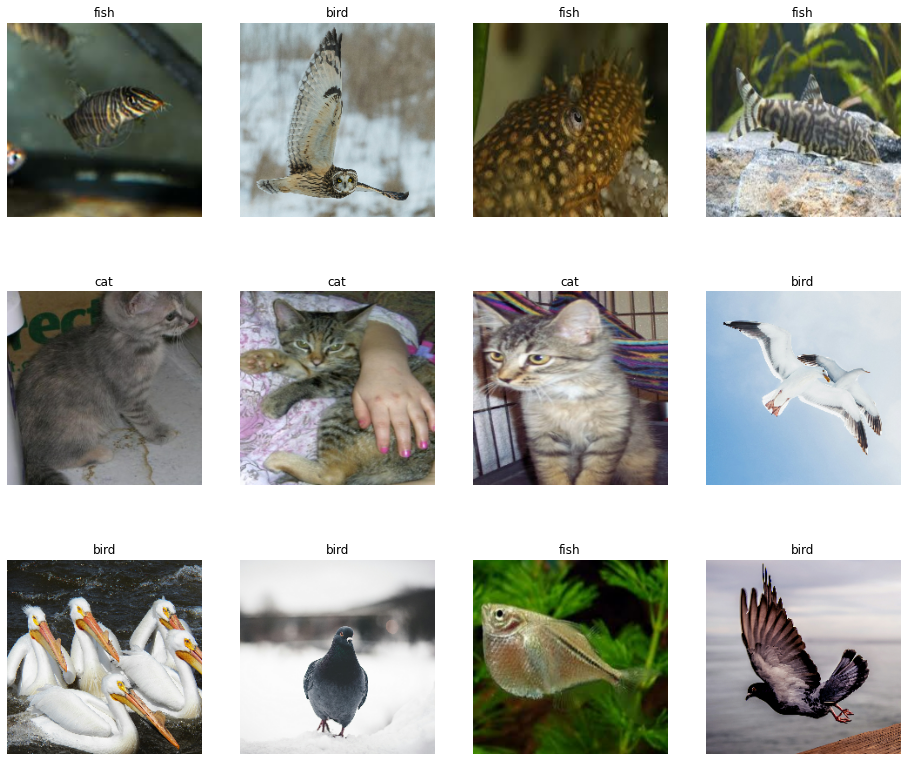

In [6]:
plt.figure(figsize=(16, 14))
for images, labels in ucna_mnozica.take(1):
    for i in range(12):
        ax = plt.subplot(3, 4, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(imena_razredov[labels[i]])
        plt.axis("off")

# Uporaba augmentacije nad slikami

Kadar nimamo velikega nabora podatkov (slik), je dobra praksa, da razblinimo monotonost med slikami z uvedbo raznolikih vzorcev. To dosežemo z uporabo naključnih a hkrati realnih transformacij nad slikami iz učne množice. Te naj bodo minimalne. Modelu s tem pomagamo izluščiti neke vzorce na slikah, istočasno pa preprečimo pretirano prileganje učnim podatkom

In [7]:
data_augmentation = keras.Sequential(
    [
        layers.experimental.preprocessing.RandomFlip('vertical', input_shape=(visina_slike, sirina_slike, 3)),
        layers.experimental.preprocessing.RandomRotation(0.3),
        layers.experimental.preprocessing.RandomZoom(0.3),
    ]
)

## Vizualizacija augmentacije
* naključna slika
* zanimivo večkrat zagnat

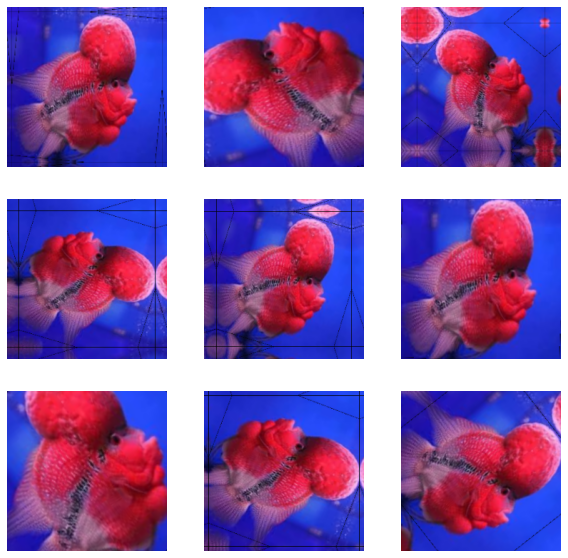

In [8]:
plt.figure(figsize=(10, 10))
for images, _ in ucna_mnozica.take(1):
    for i in range(9):
        augmented_images = data_augmentation(images)
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(augmented_images[0].numpy().astype("uint8"))
        plt.axis("off")

### Naša klasifikacija bo potekala s pomočjo konvolucijske nevrološke mreže
nekaj primerov, ki so se v praksi zelo izkazali:
* AlexNet
* LeNet
* VGG
* Xception

# Standardizacija podatkov
Do sedaj smo našim slikam že določili velikost (224x224), vendar je to komaj začetek.

Sledi izpis slike v arrayu, kjer vidimo mnogo številskih vrednosti, saj je le to RGB zapis slike (0-255). Naša želja je ta podatek standardizirati, da bojo vse te vrednosti med 0 in 1, kar je veliko bolje za učenje nevronske mreže

### Imamo dve možnosti za predprocesiranje podatkov:
* kot del modela
* vtis v podatke

### Izberem prvo, saj na ta način za učenje uporabimo GPU in ne CPUja.

In [9]:
inputs = keras.Input(shape=(224, 224, 3))
x = data_augmentation(inputs)
x = layers.experimental.preprocessing.Rescaling(1./255)(x)

AUTOTUNE = tf.data.experimental.AUTOTUNE

ucna_mnozica = ucna_mnozica.prefetch(buffer_size=AUTOTUNE)
testna_mnozica = testna_mnozica.prefetch(buffer_size=AUTOTUNE)

## Grajenje modela

In [10]:
model = Sequential()

model.add(layers.experimental.preprocessing.RandomFlip('vertical', input_shape=(visina_slike, sirina_slike, 3)))
model.add(layers.experimental.preprocessing.RandomRotation(0.3))
model.add(layers.experimental.preprocessing.RandomZoom(0.3))

model.add(layers.experimental.preprocessing.Rescaling(1./255, input_shape=(visina_slike, sirina_slike, 3))) #standardizacija slik

#1. blok
model.add(layers.Conv2D(16, 3, activation='relu')) # 16 = input
model.add(layers.MaxPooling2D())
#2. blok
model.add(layers.Conv2D(32, 3, activation='relu')) # 32 = input
model.add(layers.MaxPooling2D())
#3. blok
model.add(layers.Conv2D(64, 3, activation='relu')) # 64 = input
model.add(layers.MaxPooling2D())

model.add(layers.Dropout(0.2))            # Zaključi raven
model.add(layers.Flatten())               # Flatten

model.add(layers.Dense(90, activation='relu')) #Dense
model.add(layers.Dense(stevilo_razredov, activation='softmax'))       #Dense

model.compile(optimizer='adam', 
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), 
              metrics=[
                  'accuracy',
                  'MeanSquaredError',
                  ]) #meri točnost, napake

## Podatki o modelu

In [11]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
random_flip_1 (RandomFlip)   (None, 224, 224, 3)       0         
_________________________________________________________________
random_rotation_1 (RandomRot (None, 224, 224, 3)       0         
_________________________________________________________________
random_zoom_1 (RandomZoom)   (None, 224, 224, 3)       0         
_________________________________________________________________
rescaling_1 (Rescaling)      (None, 224, 224, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 222, 222, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 111, 111, 16)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 109, 109, 32)     

# Učenje modela

Epoch 1/35
2/2 [==============================] - 1s 496ms/step - loss: 1.1316 - accuracy: 0.3000 - mean_squared_error: 1.1218 - val_loss: 1.1031 - val_accuracy: 0.4000 - val_mean_squared_error: 1.3924
Epoch 2/35
2/2 [==============================] - 1s 491ms/step - loss: 1.1530 - accuracy: 0.3333 - mean_squared_error: 1.1757 - val_loss: 1.0442 - val_accuracy: 0.4000 - val_mean_squared_error: 1.2790
Epoch 3/35
2/2 [==============================] - 1s 460ms/step - loss: 1.0926 - accuracy: 0.4000 - mean_squared_error: 1.1126 - val_loss: 1.0295 - val_accuracy: 0.5333 - val_mean_squared_error: 1.2756
Epoch 4/35
2/2 [==============================] - 1s 417ms/step - loss: 1.0507 - accuracy: 0.4667 - mean_squared_error: 1.1134 - val_loss: 1.0321 - val_accuracy: 0.5333 - val_mean_squared_error: 1.2747
Epoch 5/35
2/2 [==============================] - 1s 404ms/step - loss: 1.0018 - accuracy: 0.5500 - mean_squared_error: 1.1084 - val_loss: 1.0872 - val_accuracy: 0.3333 - val_mean_squared_erro

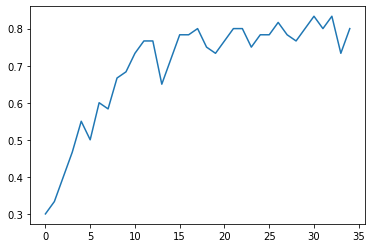

In [12]:
#SKUPAJ
st_epochs = 35 #število iteracij
rezultat = model.fit(ucna_mnozica, validation_data=testna_mnozica, epochs=st_epochs)
tocnost = rezultat.history['accuracy'] #metrika tocnosti accuracy
print("Graf preciznosti skozi iteracije")
plt.plot(range(st_epochs), tocnost, label='Tocnost ucne mnozice')
plt.show()

dict_keys(['loss', 'accuracy', 'mean_squared_error', 'val_loss', 'val_accuracy', 'val_mean_squared_error'])


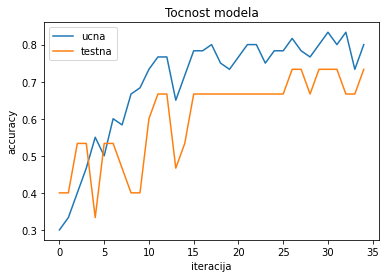

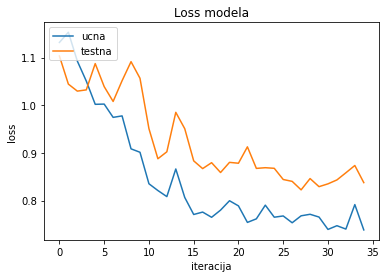

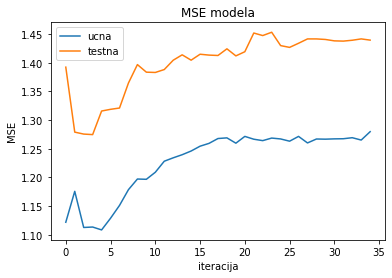

In [13]:
# list all data in history
print(rezultat.history.keys()) #kaj imamo na razpolago (dodan MSE)
# summarize history for accuracy
plt.plot(rezultat.history['accuracy'])
plt.plot(rezultat.history['val_accuracy'])
plt.title('Tocnost modela')
plt.ylabel('accuracy')
plt.xlabel('iteracija')
plt.legend(['ucna', 'testna'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(rezultat.history['loss'])
plt.plot(rezultat.history['val_loss'])
plt.title('Loss modela')
plt.ylabel('loss')
plt.xlabel('iteracija')
plt.legend(['ucna', 'testna'], loc='upper left')
plt.show()
# summarize history for mean squared error
plt.plot(rezultat.history['mean_squared_error'])
plt.plot(rezultat.history['val_mean_squared_error'])
plt.title('MSE modela')
plt.ylabel('MSE')
plt.xlabel('iteracija')
plt.legend(['ucna', 'testna'], loc='upper left')
plt.show()

### Uporaba naučenega modela nad testnimi podatki (ki jih še ni videl)
* izpis napovedi
* prikaz slike

bird, napovedano s 57.58633613586426 % točnostjo


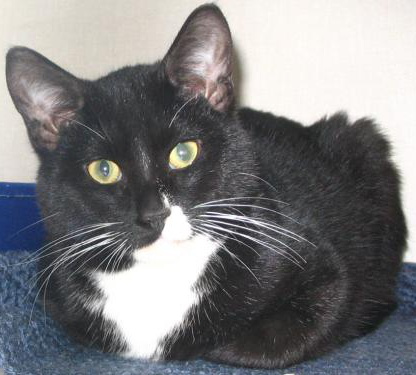

fish, napovedano s 45.33731937408447 % točnostjo


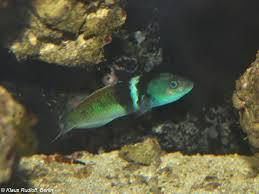

bird, napovedano s 55.37769794464111 % točnostjo


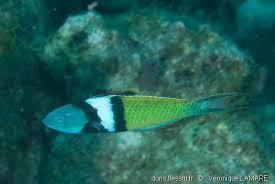

bird, napovedano s 57.52437114715576 % točnostjo


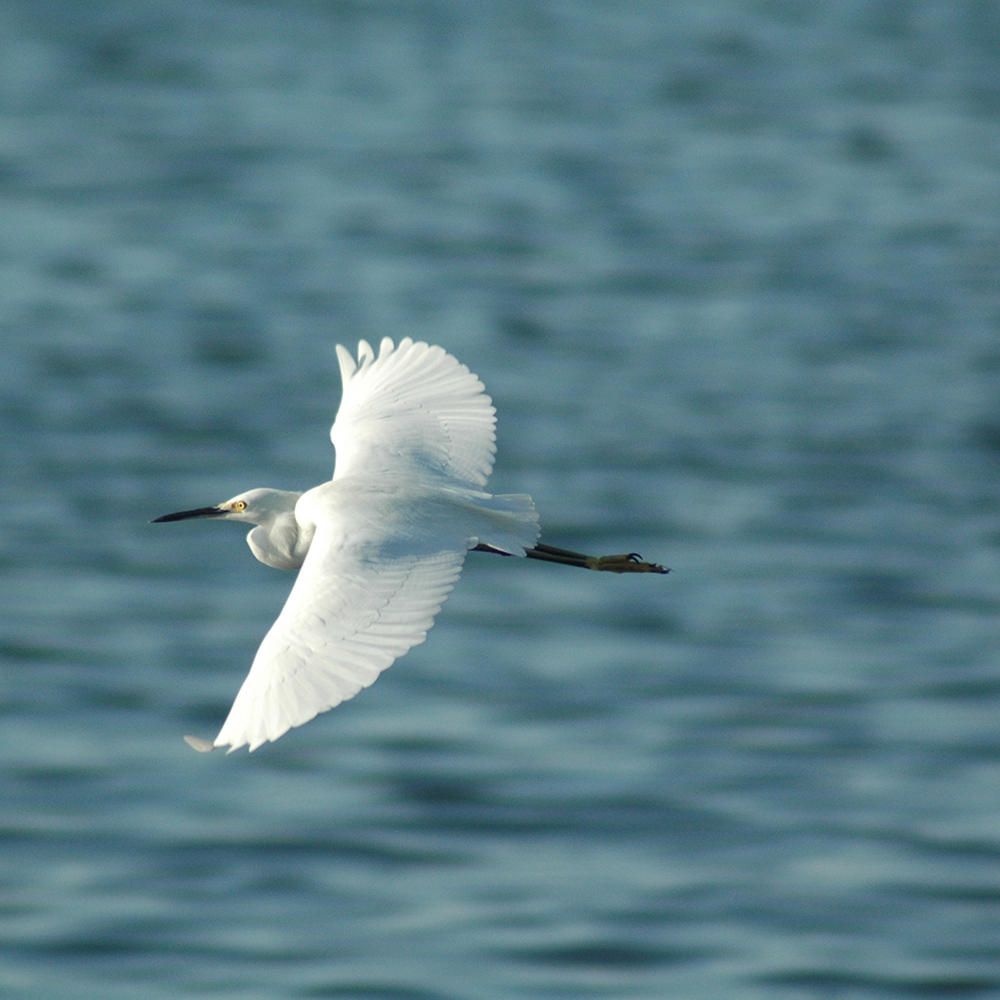

cat, napovedano s 57.59815573692322 % točnostjo


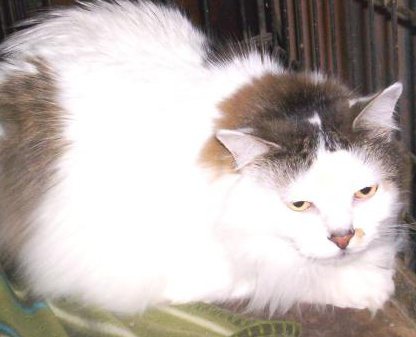

bird, napovedano s 57.35922455787659 % točnostjo


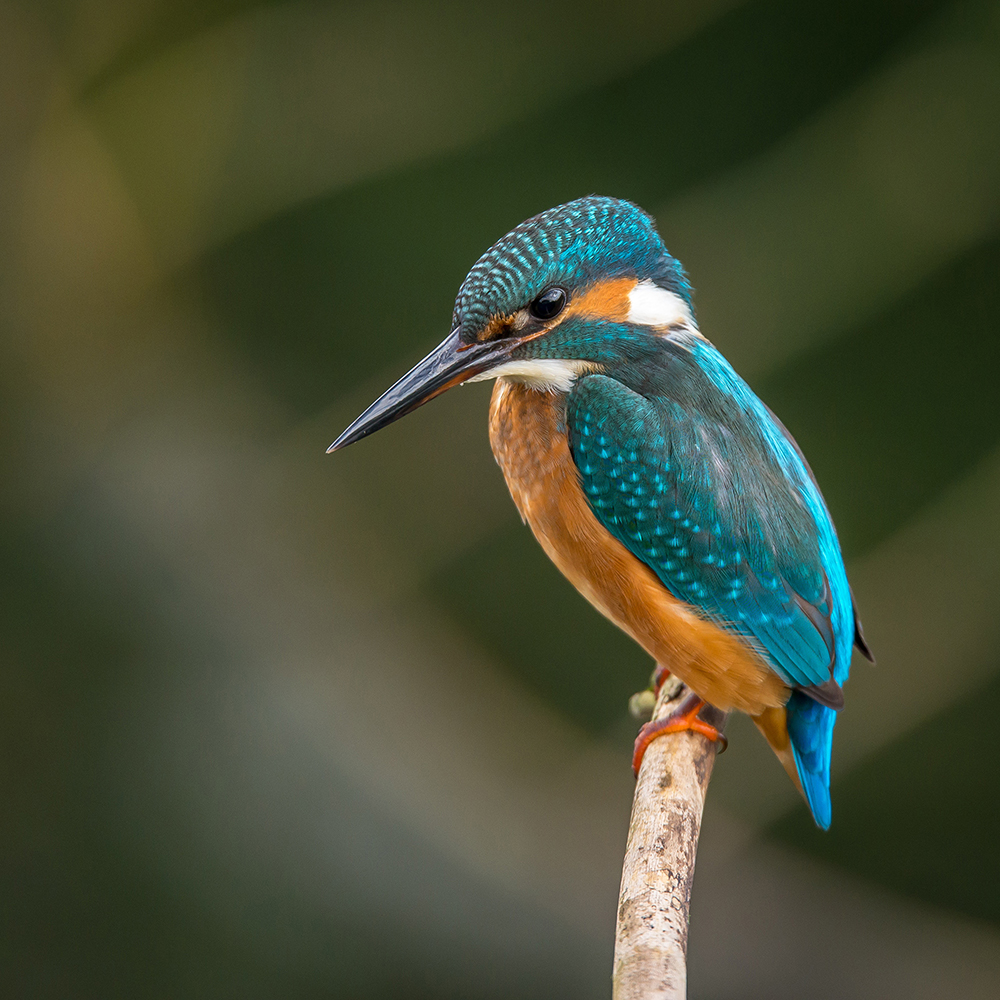

cat, napovedano s 57.56986737251282 % točnostjo


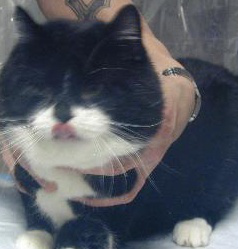

fish, napovedano s 57.558274269104004 % točnostjo


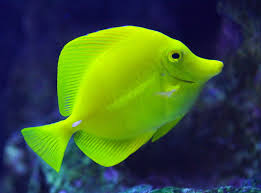

bird, napovedano s 57.61106014251709 % točnostjo


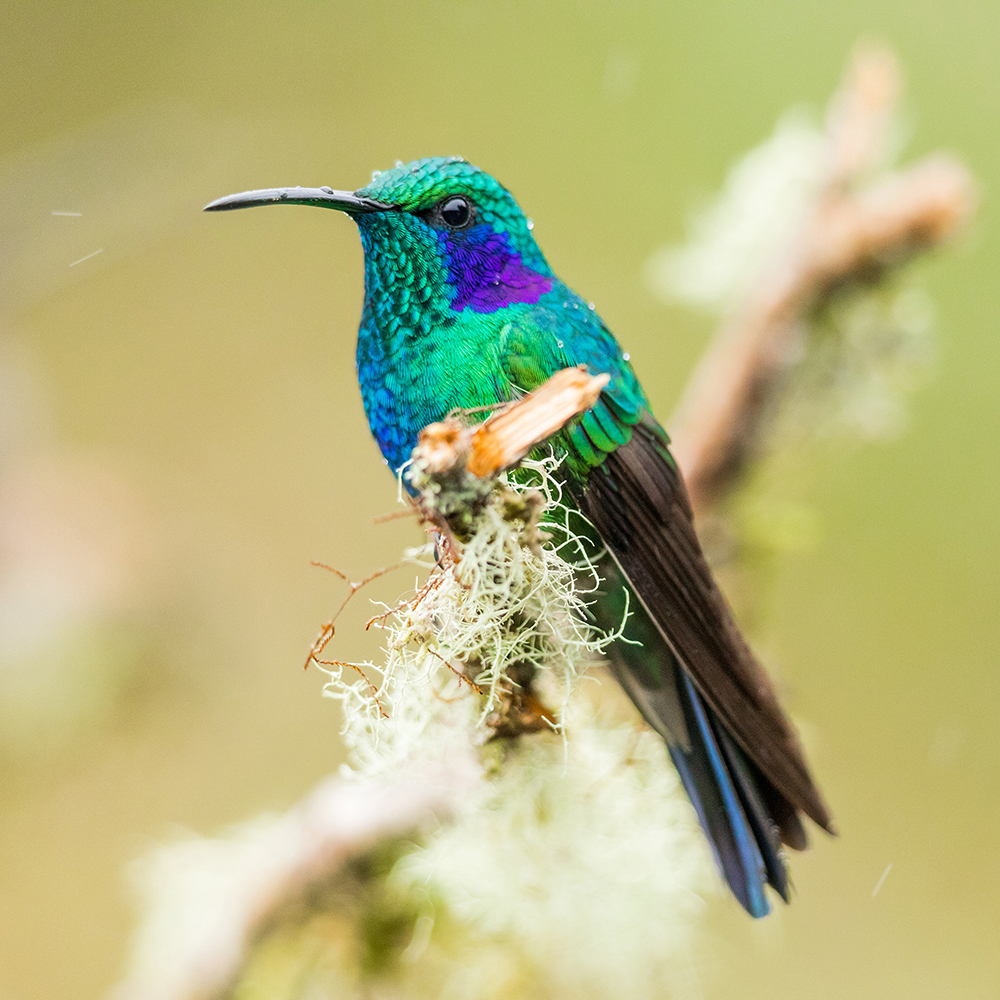

fish, napovedano s 57.59567618370056 % točnostjo


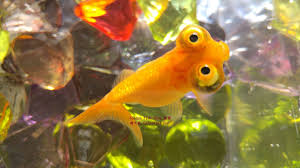

bird, napovedano s 57.61001110076904 % točnostjo


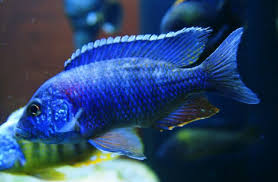

fish, napovedano s 57.09497332572937 % točnostjo


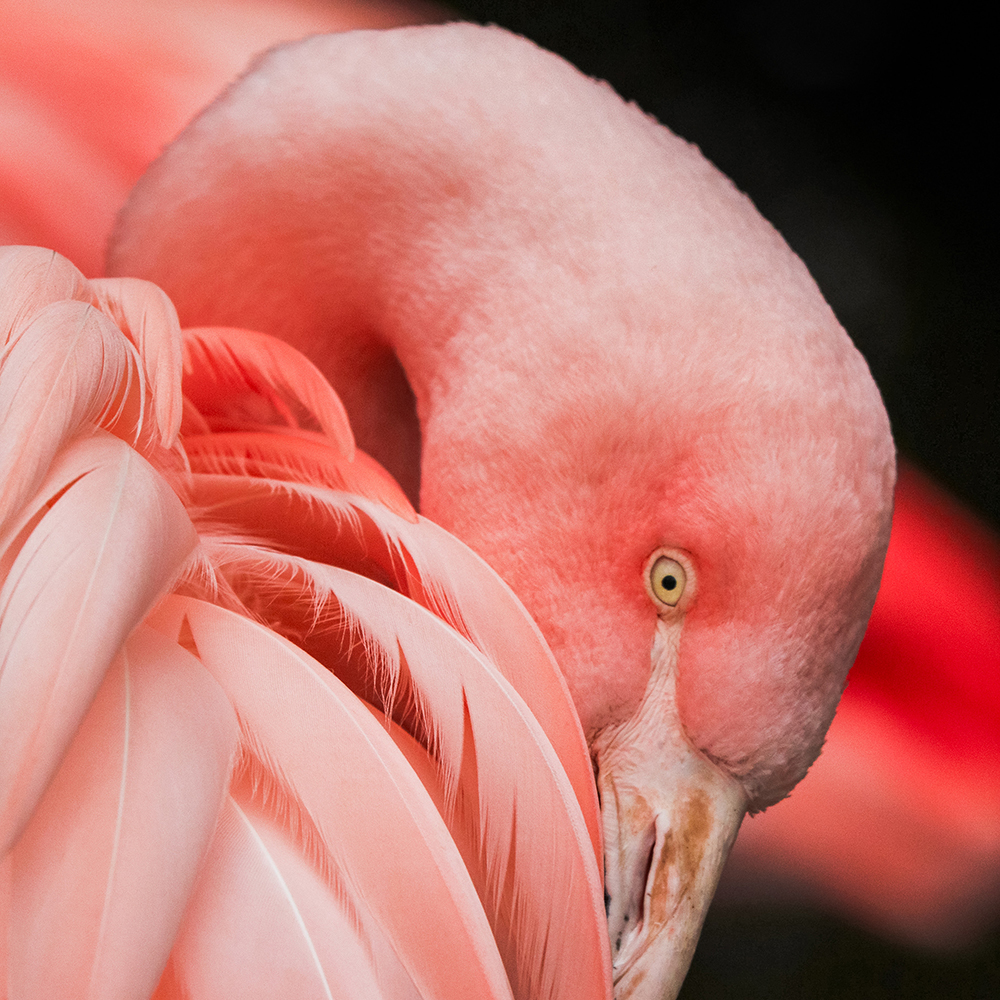

fish, napovedano s 44.801098108291626 % točnostjo


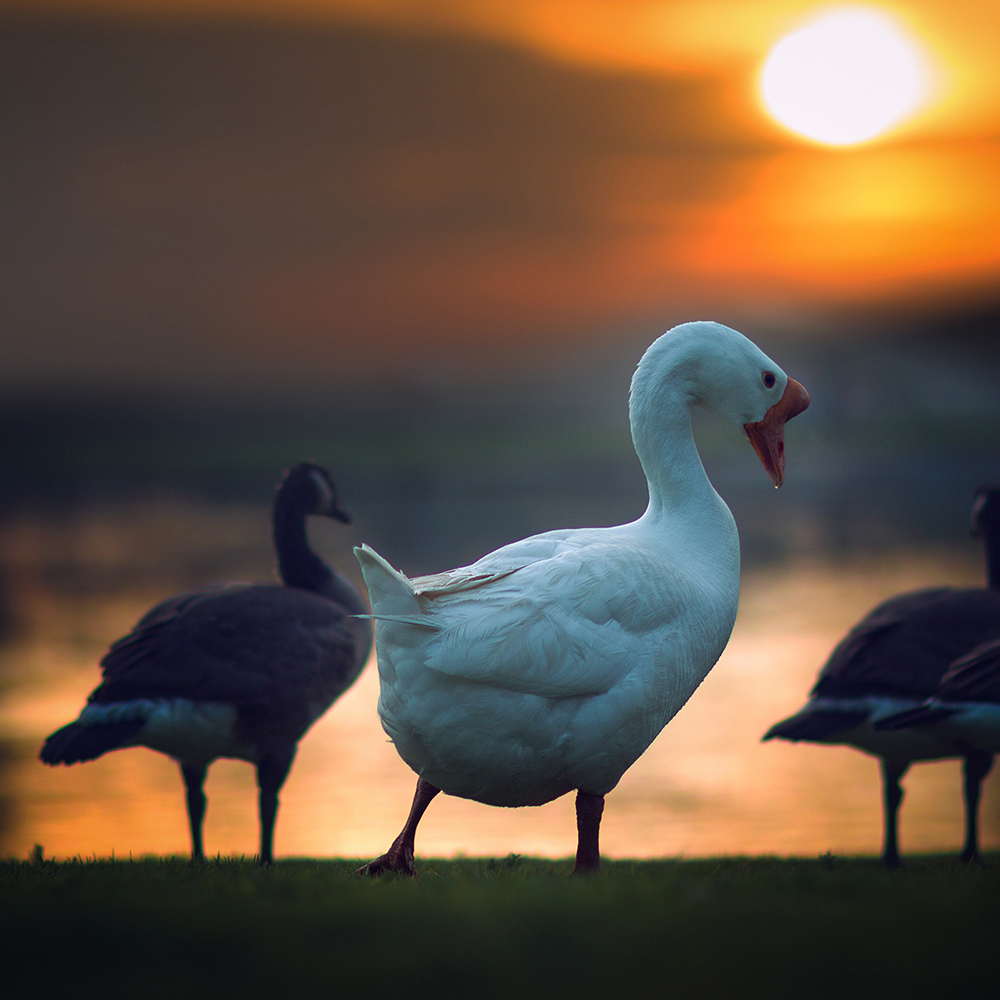

cat, napovedano s 57.59362578392029 % točnostjo


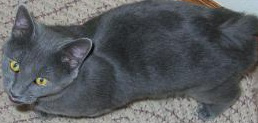

bird, napovedano s 57.61168599128723 % točnostjo


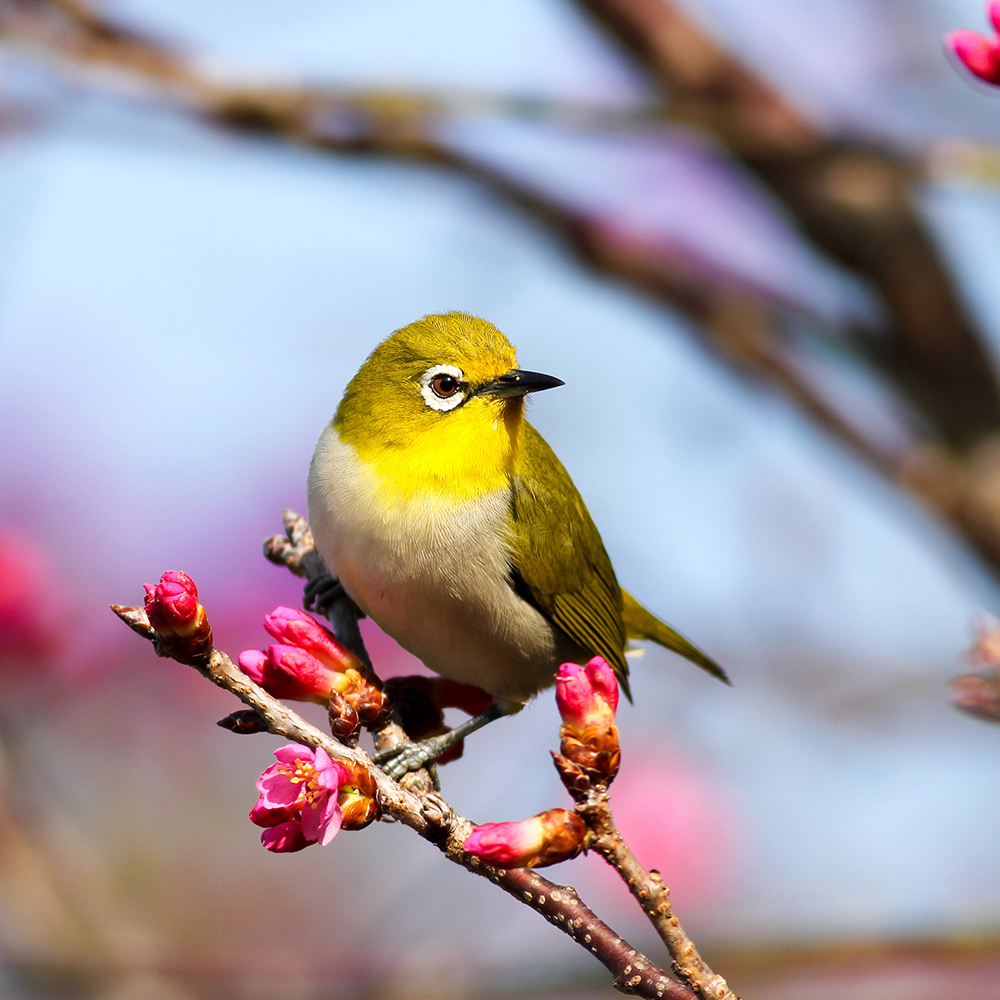

bird, napovedano s 50.49988627433777 % točnostjo


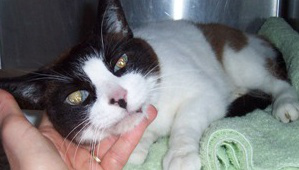

bird, napovedano s 41.30415618419647 % točnostjo


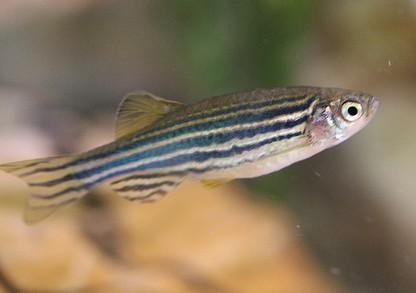

bird, napovedano s 57.404184341430664 % točnostjo


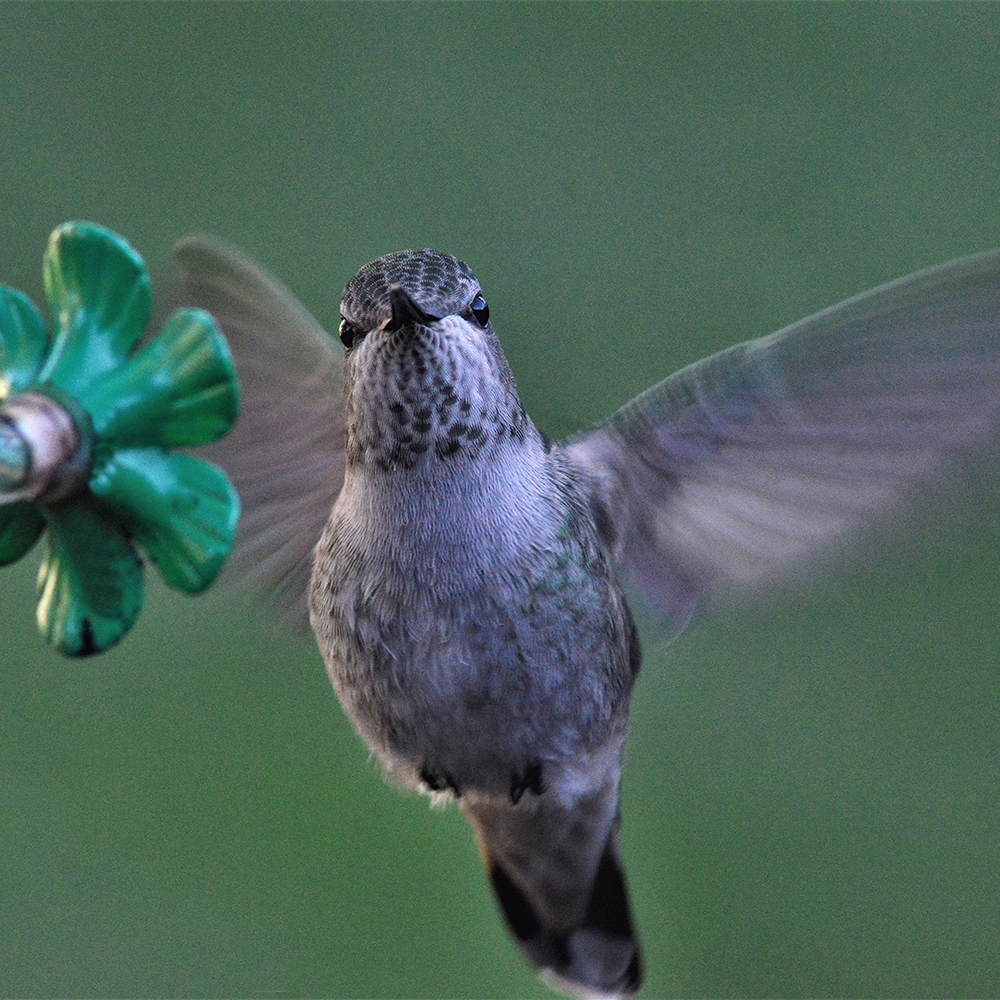

bird, napovedano s 57.61169195175171 % točnostjo


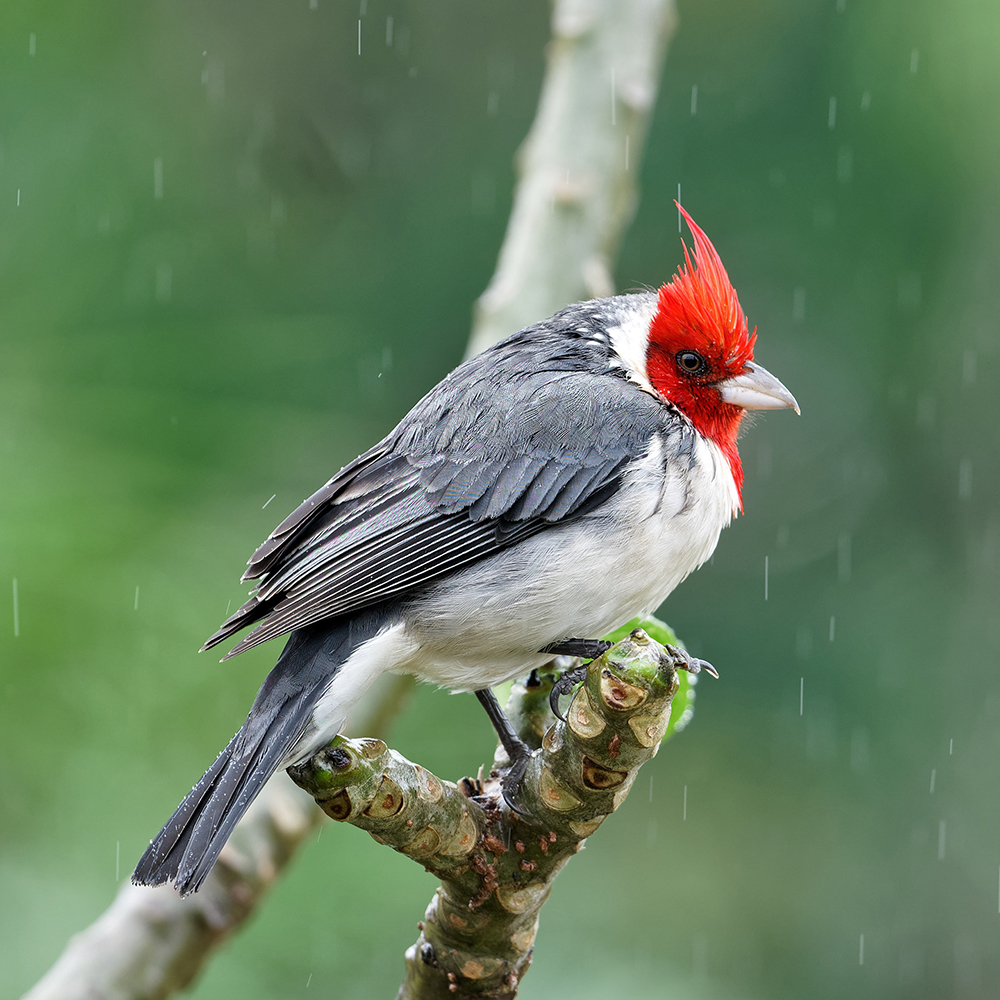

cat, napovedano s 57.60983228683472 % točnostjo


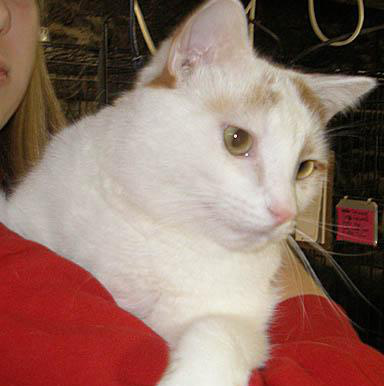

cat, napovedano s 56.673115491867065 % točnostjo


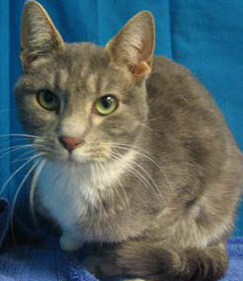

bird, napovedano s 57.61166214942932 % točnostjo


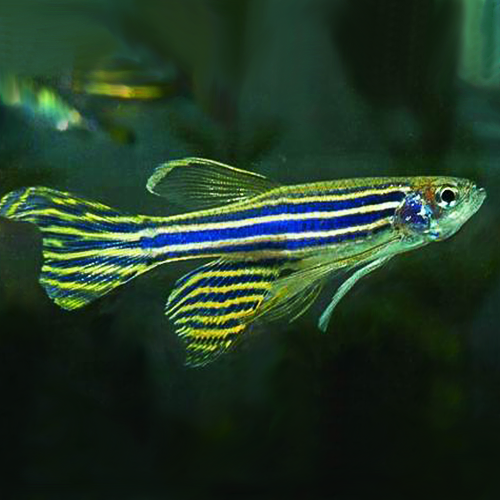

cat, napovedano s 52.911704778671265 % točnostjo


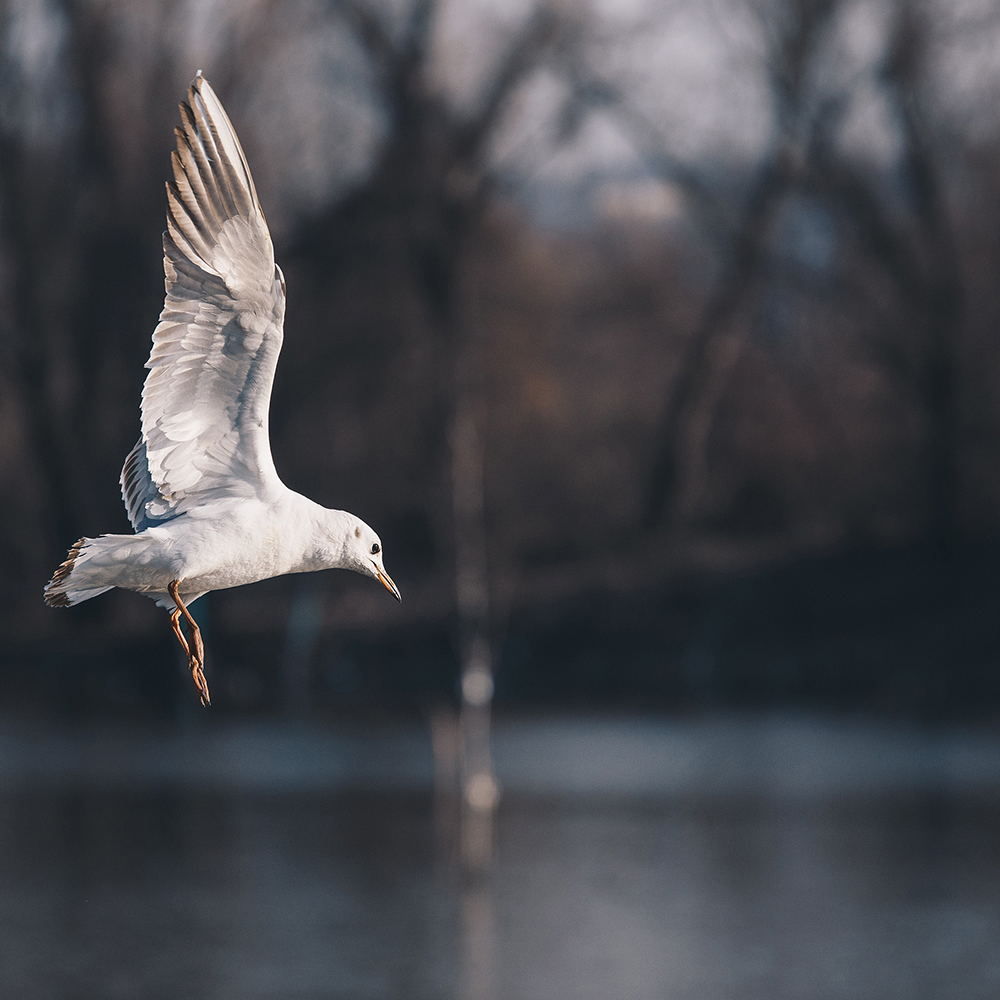

bird, napovedano s 38.88311684131622 % točnostjo


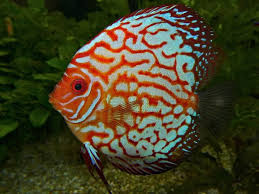

cat, napovedano s 57.600992918014526 % točnostjo


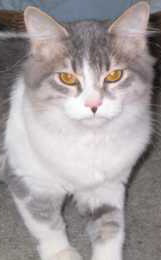

cat, napovedano s 48.50098490715027 % točnostjo


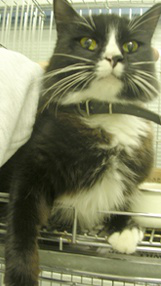

bird, napovedano s 56.80044889450073 % točnostjo


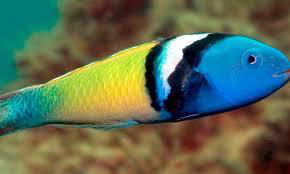

bird, napovedano s 36.62004470825195 % točnostjo


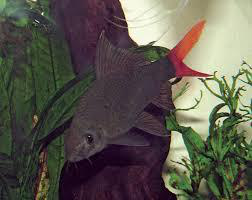

cat, napovedano s 47.41415977478027 % točnostjo


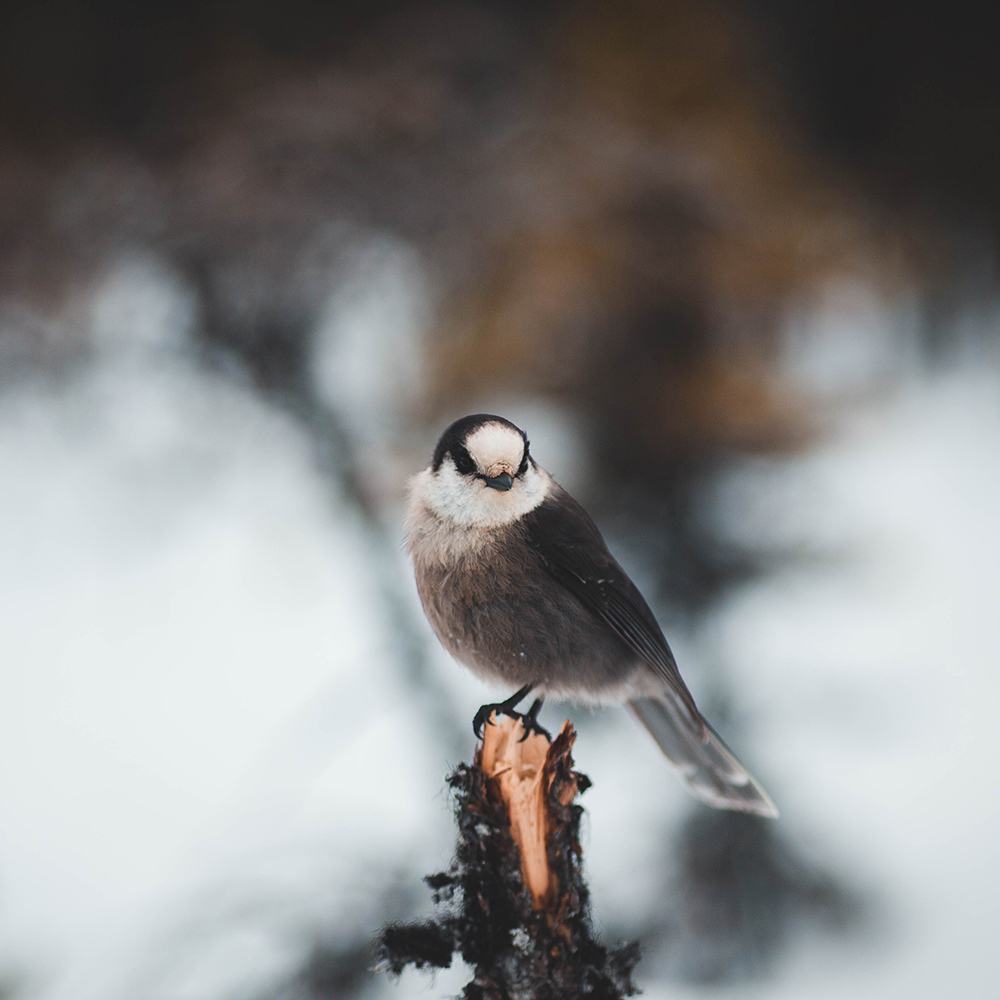

cat, napovedano s 57.60678052902222 % točnostjo


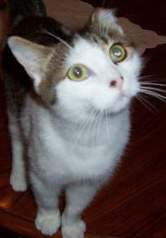

In [14]:
y_pred = []

for i in range(1,31):
    img = keras.preprocessing.image.load_img("test/"+str(i)+".jpg", target_size=(visina_slike, sirina_slike))
    img_array = keras.preprocessing.image.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0)
   
    napoved = model.predict(img_array)
    tocnost = tf.nn.softmax(napoved[0])
    
    y_pred.append(imena_razredov[np.argmax(tocnost)])
    print(imena_razredov[np.argmax(tocnost)] + ", napovedano s " + str(100 * np.max(tocnost)) + " % točnostjo")
    display(PIL.Image.open(str("test/"+str(i)+".jpg")))
    i=i+1
    


# Matrika zmede
* po stolpcih so dejanske vrednosti (true)
* po vrsticah so napovedane (prediction)

* Bird, cat, fish (program je po abecednem redu bral direktorije)

In [15]:
y_true = ["cat", "fish", "fish", "bird", "cat", "bird", "cat", "fish", "bird", "fish", "fish", "bird", "bird", "cat", "bird","cat", "fish", "bird", "bird", "cat", "cat", "fish", "bird", "fish", "cat", "cat", "fish", "fish", "bird", "cat"]

from sklearn.metrics import confusion_matrix
matrika_zmede = confusion_matrix(y_pred,y_true)
print(matrika_zmede)

#from sklearn.metrics import multilabel_confusion_matrix
#multilabel_confusion_matrix(y_true, y_pred, labels=["cat", "bird", "fish"])

[[6 2 7]
 [2 8 0]
 [2 0 3]]


### Uporaba scikit.learns
Ker sem prvič delal metrike na algoritmu CNN v kombinaciji s knjižnico, sem se odločil, da preverim, če zadeva poda pravilen izpis za moj primer (če sem pravilno vnesel podatke ipd.)
* Eden izmed primerov učenja je podal rezultat (v obliki matrike zmede): 

                                            matrika zmede testnega primera

|4|1|4|
|------|------|------|
|2|9|3|
|4|0|3|

Ročno sem preveril napoved in kar je na sliki, matrika zmede je pravilna. Obrnil sem samo vrstice/stolpce, da imam po stolpcih dejanske vrednosti in po vrsticah napovedane Nato sem ročno (A) ter s knjižnico (B) izračunal preciznost ( tp / (tp + fp) ) 
* A) 4/9 ; 9/14 ; 3/7 = [0,44444 ; 0.6428571428571429 ; 0.42857142857142855] 
* B) array([0.44444444, 0.64285714, 0.42857143]) (average = None)

Odločitev je padla, delo si bom olajšal s knjižnico scikit.learns, dokumentacija mi je blizu
![1](.github/images/1.png)
<b> V tem primeru po vrsticah računamo preciznost in po stolpcih priklic</b>

# Točnost, preciznost, priklic
* Točnost: (tp / all) - diagonala v matriki zmede / vsi
* Precision: tp / (tp + fp), zmožnost algoritma, da ne označi pozitivnega kot negativnega
* Priklic: tp / (tp + fn), zmožnost algoritma, da najde pozitivne primerke

In [16]:
from sklearn.metrics import accuracy_score
tocnost = accuracy_score(y_true, y_pred, normalize=True)
print("Točnost našega modela je: " + str(tocnost))

from sklearn.metrics import precision_score
preciznost = precision_score(y_true, y_pred, average='weighted')
print("Preciznost našega modela je: " + str(preciznost))

from sklearn.metrics import recall_score
priklic = recall_score(y_true, y_pred, average='weighted')
print("Priklic našega modela je: " + str(priklic))

Točnost našega modela je: 0.5666666666666667
Preciznost našega modela je: 0.6
Priklic našega modela je: 0.5666666666666667


# F mera
* 2 * (preciznost * priklic) / (preciznost + priklic)

In [17]:
from sklearn.metrics import f1_score
print("F-mera za vsak klasificiran razred posebaj: ")
print(f1_score(y_true, y_pred, average=None))
print("Skupna F-mera")
print(f1_score(y_true, y_pred, average='weighted'))

F-mera za vsak klasificiran razred posebaj: 
[0.48 0.8  0.4 ]
Skupna F-mera
0.56


# Primerjava z Efficient Net B0
Ob branju literature sem našel model "Efficient Net B0" (scaling med b1 - b7)
* Našel sem model, ki je relativno mlad in zelo hvaljen glede svoje točnosti

Torej, kaj sploh je "Efficient Net"?

Podjetje Google je objavilo zanimiv strokovni članek skupaj z izvorno kodo na "novo" zasnovane konvolucijske nevronske mreže, ki bi naj podirala rekorde glede točnosti ter hkrati še hitrosti, dal sem ji priložnost. Na koncu si bomo pogledali še primerjavo modelov, bistvena razlika pa je, da ima ta model že vnaprej določene uteži, saj je vnaprej (delno) natreniran.

In [18]:
from tensorflow.keras.applications import EfficientNetB0

inputs = layers.Input(shape=(224, 224, 3))
x = data_augmentation(inputs)
model3 = EfficientNetB0(include_top=False, input_tensor=x, weights='imagenet')

model3.trainable = False

x = layers.GlobalAveragePooling2D(name="avg_pool")(model3.output)
x = layers.BatchNormalization()(x)

top_dropout_rate = 0.2
x = layers.Dropout(top_dropout_rate, name="top_dropout")(x)
outputs = layers.Dense(3, activation="softmax")(x)
 
# Compile
model3 = tf.keras.Model(inputs, outputs, name="EfficientNet")
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-2)
model3.compile(optimizer=optimizer,
               loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
               metrics=[
                   "accuracy",
                   'MeanSquaredError',
                   ])
epochs = 35  # @param {type: "slider", min:10, max:100}
hist3 = model3.fit(ucna_mnozica, epochs=epochs, validation_data=testna_mnozica, verbose=2)
tocnost3 = hist3.history['accuracy'] #metrika tocnosti accuracy

Epoch 1/35
2/2 - 3s - loss: 0.9458 - accuracy: 0.5333 - mean_squared_error: 1.2024 - val_loss: 0.7396 - val_accuracy: 0.8667 - val_mean_squared_error: 1.3475
Epoch 2/35
2/2 - 2s - loss: 0.5958 - accuracy: 0.9667 - mean_squared_error: 1.2849 - val_loss: 0.6536 - val_accuracy: 0.9333 - val_mean_squared_error: 1.4010
Epoch 3/35
2/2 - 2s - loss: 0.5799 - accuracy: 0.9833 - mean_squared_error: 1.2920 - val_loss: 0.6250 - val_accuracy: 0.9333 - val_mean_squared_error: 1.4224
Epoch 4/35
2/2 - 2s - loss: 0.5743 - accuracy: 0.9667 - mean_squared_error: 1.2909 - val_loss: 0.6101 - val_accuracy: 0.9333 - val_mean_squared_error: 1.4333
Epoch 5/35
2/2 - 1s - loss: 0.5643 - accuracy: 0.9833 - mean_squared_error: 1.2932 - val_loss: 0.5996 - val_accuracy: 0.9333 - val_mean_squared_error: 1.4398
Epoch 6/35
2/2 - 2s - loss: 0.5636 - accuracy: 0.9833 - mean_squared_error: 1.2957 - val_loss: 0.5919 - val_accuracy: 0.9333 - val_mean_squared_error: 1.4440
Epoch 7/35
2/2 - 2s - loss: 0.5536 - accuracy: 1.000

In [19]:
model3.summary()

Model: "EfficientNet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
sequential (Sequential)         (None, 224, 224, 3)  0           input_2[0][0]                    
__________________________________________________________________________________________________
rescaling_2 (Rescaling)         (None, 224, 224, 3)  0           sequential[1][0]                 
__________________________________________________________________________________________________
normalization (Normalization)   (None, 224, 224, 3)  7           rescaling_2[0][0]                
_______________________________________________________________________________________

dict_keys(['loss', 'accuracy', 'mean_squared_error', 'val_loss', 'val_accuracy', 'val_mean_squared_error'])


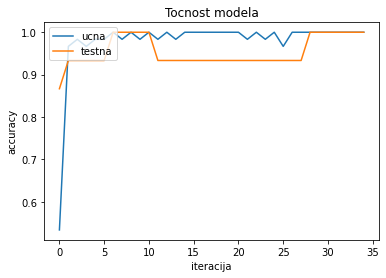

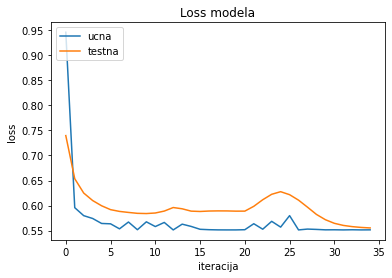

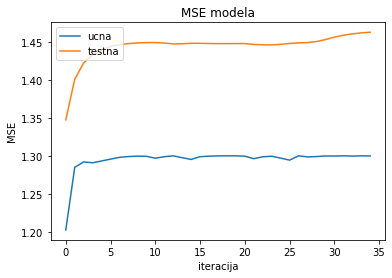

In [20]:
# list all data in history
print(hist3.history.keys()) #kaj imamo na razpolago (dodan MSE)
# summarize history for accuracy
plt.plot(hist3.history['accuracy'])
plt.plot(hist3.history['val_accuracy'])
plt.title('Tocnost modela')
plt.ylabel('accuracy')
plt.xlabel('iteracija')
plt.legend(['ucna', 'testna'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(hist3.history['loss'])
plt.plot(hist3.history['val_loss'])
plt.title('Loss modela')
plt.ylabel('loss')
plt.xlabel('iteracija')
plt.legend(['ucna', 'testna'], loc='upper left')
plt.show()
# summarize history for mean squared error
plt.plot(hist3.history['mean_squared_error'])
plt.plot(hist3.history['val_mean_squared_error'])
plt.title('MSE modela')
plt.ylabel('MSE')
plt.xlabel('iteracija')
plt.legend(['ucna', 'testna'], loc='upper left')
plt.show()

### Predikcija z Efficient Net B0

In [ ]:
y_pred3 = []
#Dodam novo vnešene testne podatke
y_true3 = ["cat", "fish", "fish", "bird", "cat", "bird", "cat", "fish", "bird", "fish", "fish", "bird", "bird", "cat", "bird","cat", "fish", "bird", "bird", "cat", "cat", "fish", "bird", "fish", "cat", "cat", "fish", "fish", "bird", "cat", "cat", "cat", "cat", "fish", "fish", "fish", "bird", "bird", "bird"]

for i in range(1,40):
    img3 = keras.preprocessing.image.load_img("test/"+str(i)+".jpg", target_size=(visina_slike, sirina_slike))
    img_array3 = keras.preprocessing.image.img_to_array(img3)
    img_array3 = tf.expand_dims(img_array3, 0)
   
    napoved3 = model3.predict(img_array3)
    tocnost3 = tf.nn.softmax(napoved3[0])
    
    y_pred3.append(imena_razredov[np.argmax(tocnost3)])
    print(imena_razredov[np.argmax(tocnost3)] + ", napovedano s " + str(100 * np.max(tocnost3)) + " % točnostjo")
    display(PIL.Image.open(str("test/"+str(i)+".jpg")))
    i=i+1

# Zaključek
### Primerjava med modeloma

Drugi model je veliko boljši, saj je že prej natreniran in utežen na velikem datasetu.

Poskusil sem ga sam natrenirati, vendar je proces časovno prezahteven, meni pa je ob računalniku postalo vroče
## Matriki zmede

In [22]:
matrika_zmede3 = confusion_matrix(y_pred3,y_true3)

print("Moj model:  ") 
print(matrika_zmede)
print("\n")
print("Model Efficient Net B0:  ")
print(matrika_zmede3)

Moj model:  
[[6 2 7]
 [2 8 0]
 [2 0 3]]


Model Efficient Net B0:  
[[12  1  0]
 [ 1 12  0]
 [ 0  0 13]]


## Primerjava točnosti, preciznosti in priklica

In [23]:
print("Točnost našega modela je: " + str(tocnost))
tocnost3 = accuracy_score(y_true3, y_pred3, normalize=True)
print("Točnost modela Efficient Net B0 je: " + str(tocnost3) + "\n")

print("Preciznost našega modela je: " + str(preciznost))
preciznost3 = precision_score(y_true3, y_pred3, average='weighted')
print("Preciznost modela Efficient Net B0 je: " + str(preciznost3) + "\n")

print("Priklic našega modela je: " + str(priklic))
priklic3 = recall_score(y_true3, y_pred3, average='weighted')
print("Priklic modela Efficient Net B0 je: " + str(priklic3))

Točnost našega modela je: 0.5666666666666667
Točnost modela Efficient Net B0 je: 0.9487179487179487

Preciznost našega modela je: 0.6
Preciznost modela Efficient Net B0 je: 0.9487179487179487

Priklic našega modela je: 0.5666666666666667
Priklic modela Efficient Net B0 je: 0.9487179487179487


## Primerjava F-mere
* Razlika je očitna
* Model, ki je bil treniran nad ogromno učno množico, ima veliko prednost
* Ob treniranju je B0 imel nekje 1-2 napaki med 40 testnimi podatki
* Moj model je imel cca 40% napak med 30 testnimi podatki

In [24]:
print("Moj model F-score:  ") 
print(str(f1_score(y_true, y_pred, average='weighted')) + "\n")
print("Model Efficient Net B0 F-score:  ")
print(f1_score(y_true3, y_pred3, average='weighted'))


Moj model F-score:  
0.56

Model Efficient Net B0 F-score:  
0.9487179487179487


<b> Prav tako sem opazil, da je model B0 imel napake tudi med prvimi 30 slikami, kar pomeni, da verjetno te slike niso bile v učni množici, temveč je tako zelo natančen. </b>